<a href="https://colab.research.google.com/github/ravilanke-numberplate/tesseract-opencv/blob/master/shrimp_train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# UNZIPPING THE DATASET


In [ ]:
!unzip -q /content/dataset-001.zip

#CLONING THE YOLO-V5 FILES FROM OFFICIAL REPOSITORY

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 13138, done.
remote: Counting objects: 100% (16/16), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 13138 (delta 7), reused 12 (delta 4), pack-reused 13122
Receiving objects: 100% (13138/13138), 12.52 MiB | 30.24 MiB/s, done.
Resolving deltas: 100% (9020/9020), done.


# CHANGING THE DIRECTORY

In [ ]:
%cd yolov5/

/content/yolov5


#INSTALLING THE DEPENDENCIES

In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 596 kB 5.2 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


# DOWNLOADING ALL VERSIONS OF YOLO-V5 MODEL

In [ ]:
!/content/yolov5/data/scripts/download_weights.sh

100% 3.87M/3.87M [00:00<00:00, 59.8MB/s]

100% 14.1M/14.1M [00:00<00:00, 141MB/s]

100% 40.8M/40.8M [00:00<00:00, 206MB/s]

100% 89.3M/89.3M [00:06<00:00, 14.8MB/s]

100% 166M/166M [00:00<00:00, 227MB/s]

100% 6.86M/6.86M [00:00<00:00, 74.5MB/s]

100% 24.8M/24.8M [00:00<00:00, 36.8MB/s]

100% 69.0M/69.0M [00:00<00:00, 88.4MB/s]

100% 147M/147M [00:01<00:00, 86.0MB/s]

100% 270M/270M [00:07<00:00, 37.0MB/s]



# STEPS BEFORE TRAINING CUSTOM DATASET:
1. Go to yolov5/data/
2. Open coco128.yaml
3. Edit the following inside it:
    

      1.   Training and Test file path
      2.   Number of classes and Class names.



# TRAINING THE YOLO-V5 MODEL

In [9]:
!python train.py --img 415 --batch 32 --epochs 500 --data coco128.yaml --weights yolov5s.pt  

train: weights=yolov5s.pt, cfg=, data=coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=32, imgsz=415, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-320-gb367860 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4

# VISUALIZING THE TRAINING METRICS

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

# TESTING

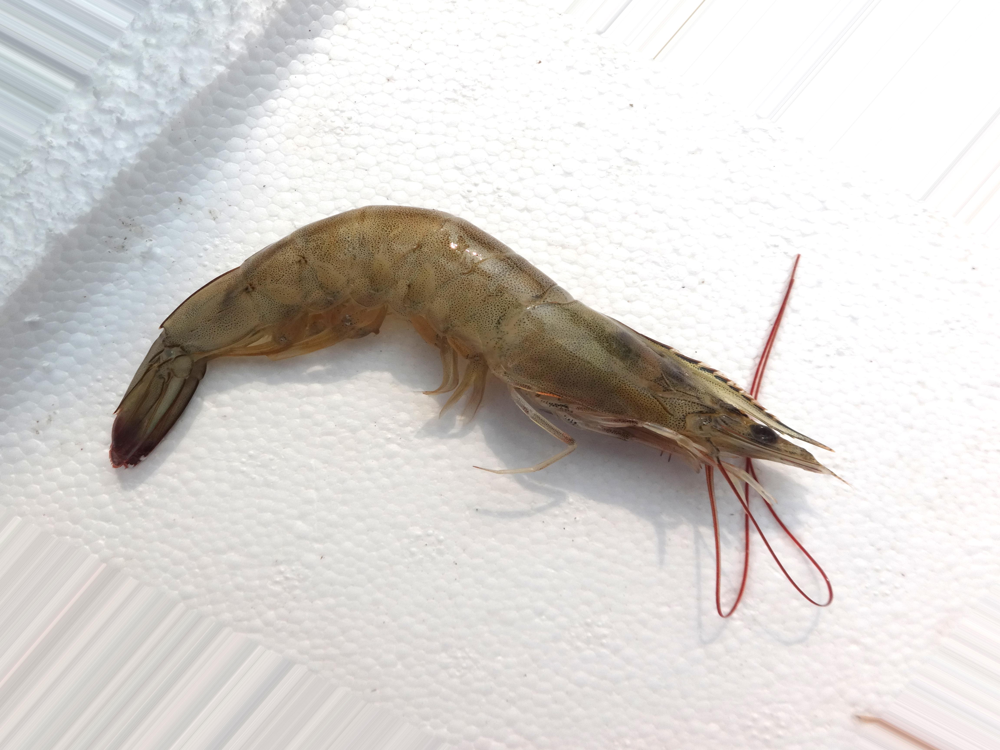

In [13]:
from PIL import Image
Image.open('/content/yolov5/runs/train/exp2/image_0_1659.jpeg')

In [ ]:
!python detect.py --source runs/train/exp2/a.jpg --weights best.pt

In [15]:
!python val.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --data coco128.yaml --img 416 

val: data=/content/yolov5/data/coco128.yaml, weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-320-gb367860 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning '/content/dataset/valid/labels.cache' images and labels... 11 found, 0 missing, 0 empty, 0 corrupt: 100% 11/11 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 1/1 [00:00<00:00,  3.11it/s]
                 all         11         20      0.997          1      0.995      0.863
Speed: 0.1ms pre-process, 5.7ms inference, 2.9ms NMS per image at shape (32, 3, 416, 416)
Re

# DETECTING ON NEW IMAGES

In [16]:
!python detect.py --source /content/dataset/test/images --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 416 --save-txt --save-conf

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/dataset/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-320-gb367860 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/7 /content/dataset/test/images/1658649631953_jpg.rf.c3ded881f69b9e0f1c1fa0c425ce54d9.jpg: 416x416 1 1, Done. (0.008s)
image 2/7 /content/dataset/test/images/1658649631987_jpg.rf.5db0ed9e396b8bbdd70eb01858de1d32.jpg: 416x416 2 1s, Done. (0.008s)
image 3/7 /content/dataset/test/images/1658649632614_jpg.rf.f656c188dba7ba0cc2f5c9b

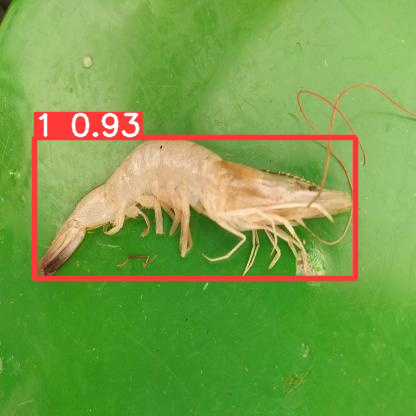

In [17]:
Image.open('/content/yolov5/runs/detect/exp/1658649631953_jpg.rf.c3ded881f69b9e0f1c1fa0c425ce54d9.jpg')

#RETRAINING FROM THE LAST CHECKPOINT

In [ ]:
!python train.py --weights /content/yolov5/runs/train/exp/weights/best.pt --epochs 300 --img 416

train: weights=/content/yolov5/runs/train/exp/weights/best.pt, cfg=, data=data/coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gam

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import re
path='/content/yolov5/runs/detect/exp2/labels/11_image.txt'
myfile=open(path,'r')
lines=myfile.readlines()
pattern= "class_name"

cordinate = []
for line in lines:
  for x in line.splitlines():
    cordinate.append([x[1:]])
#   if re.search(pattern,line):
#     Cord_Raw=line
# Cord=Cord_Raw.split("(")[1].split(")")[0].split("  ")

In [ ]:
cordinate

[[' 0.232738 0.407953 0.241975 0.188535 0.84375'],
 [' 0.571775 0.499394 0.132041 0.104158 0.878906']]

In [ ]:
cordinate[0]

[' 0.232738 0.407953 0.241975 0.188535 0.84375']

In [ ]:

import cv2
img = cv2.imread("/content/drive/MyDrive/images/train/11_image.jpg")
print(img.shape)
for i in cordinate:
  count= 0
  for val in i:
    value = val.strip().split(" ")
    x_min = int(float(value[0])*img.shape[0])
    x_max = x_min + int(float(value[2])*img.shape[0])
    y_min = int(float(value[1])*img.shape[1])
    y_max = y_min + int(float(value[3])*img.shape[1])
    crop_img = img[y_min:y_max, x_min:x_max]
    cv2.imwrite(f"Object_{count}.jpg",crop_img)
    count = count + 1





(2477, 3302, 3)


0

In [ ]:
import cv2
img = cv2.imread("/content/drive/MyDrive/images/train/11_image.jpg")
crop_img = img[y_min:y_max, x_min:x_max]
cv2.imwrite("Object.jpg",crop_img)